Blurring & Smoothing:

Common operations of image processing.

Smoothing helps to get rid of noise. (to make it focus on general details)

Blurring & smoothing are combined with edge detection.

Edge detection algorithms, if not blurring, may detect many unwanted edges.

## Methods:
#### > Kernel-Based Filtering (Convolution Filters)
kernels -------Applied on Image ------Produces-----> variety of effects

Smoothing and blurring depend on kernel operations.

Image kernels are applied, especially just for small matrix

It is used to apply effects (smoothing effect, blurring effect)

kernels for 

-sharpen

-blur

-identify

-outline

#### > Gamma Correction:
(not for smoothing/blurring)

but applied to the image to make it appear brighter/darker depending on gamma value. (γ=1,2,1/3,1/4,1/2)

Ex: photo correction
#### > Gaussian Blurring 
#### > Median Blurring
#### > Bilateral Filtering

In [3]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

In [8]:
#function to load_image:
def load_img(path):
    #making it pixel b/w 0-1
    img=cv2.imread(path).astype(np.float32)/255
    #color conversion:
    img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

In [9]:
#function to display image:
def display_img(img):
    fig=plt.figure(figsize=(12,10))
    ax=fig.add_subplot(111)
    ax.imshow(img)

In [10]:
image = load_img('Data/bricks.jpg')

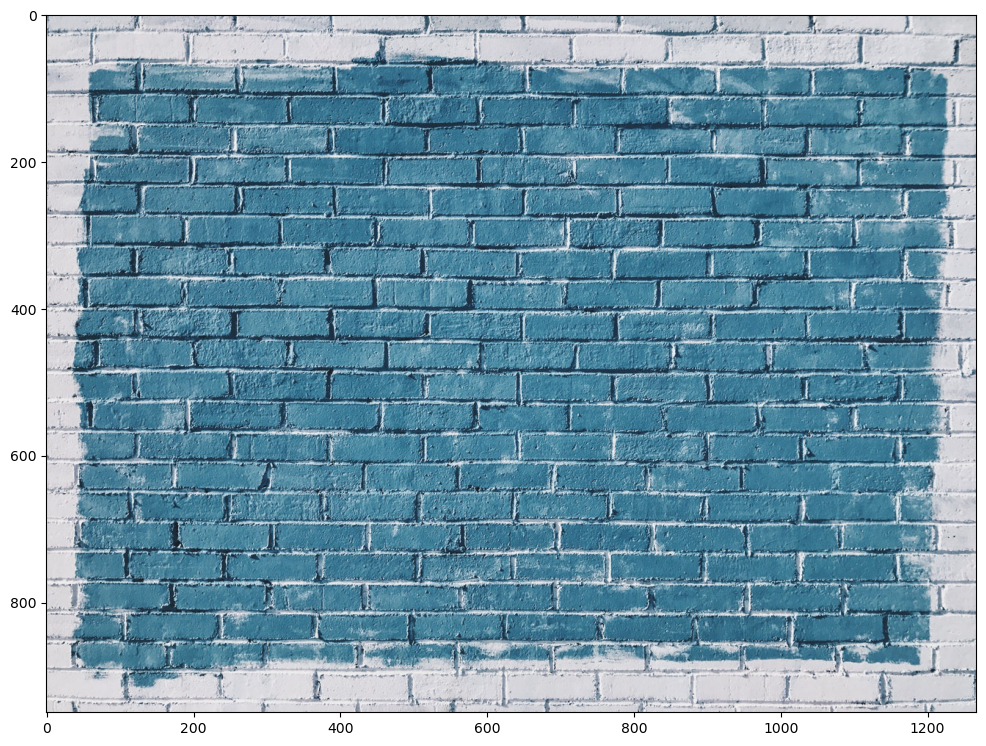

In [11]:
display_img(image)

## GAMMA CORRECTION:

In [13]:
#to increase or decrease brightness.
#gamma(γ)<1 - brighter

gamma = 1/4

gma_crt_img = np.power(image, gamma)
#here every pixel is raised to power of γ. this affects image(make it bright or dark)

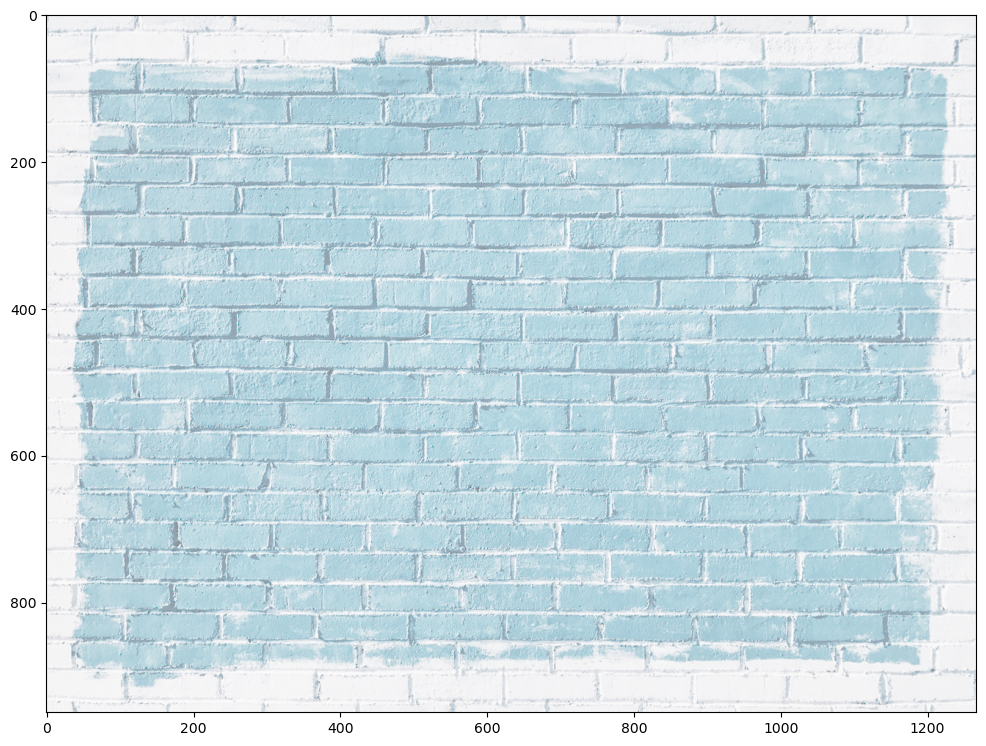

In [14]:
display_img(gma_crt_img)

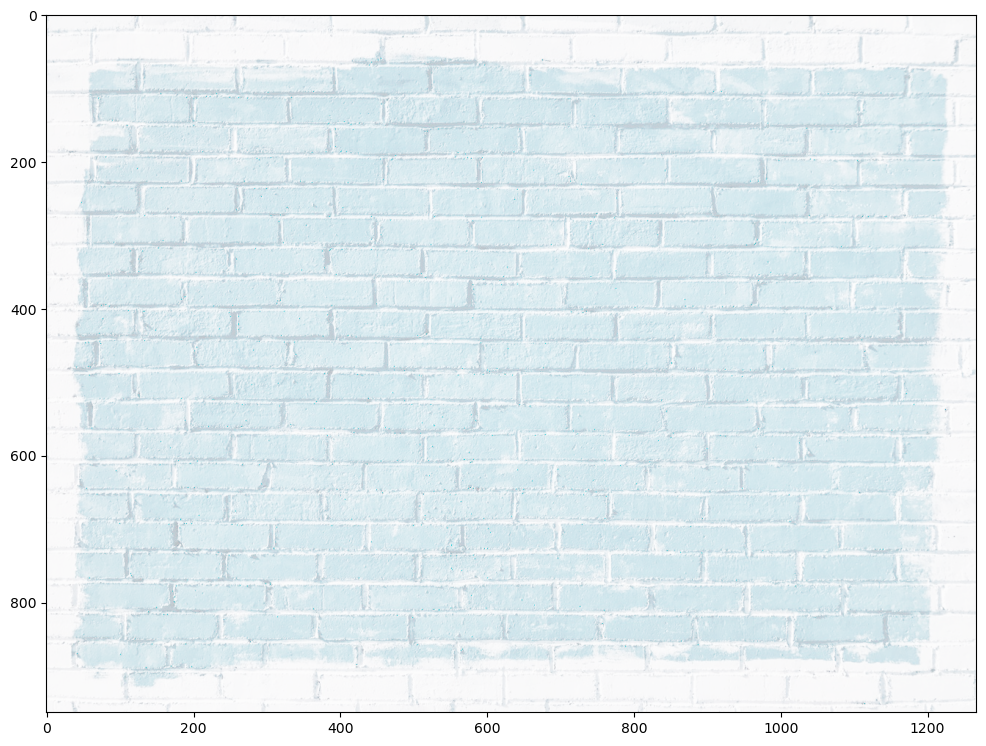

In [16]:
gamma = 1/8
gma_crt_img = np.power(image, gamma)
display_img(gma_crt_img)

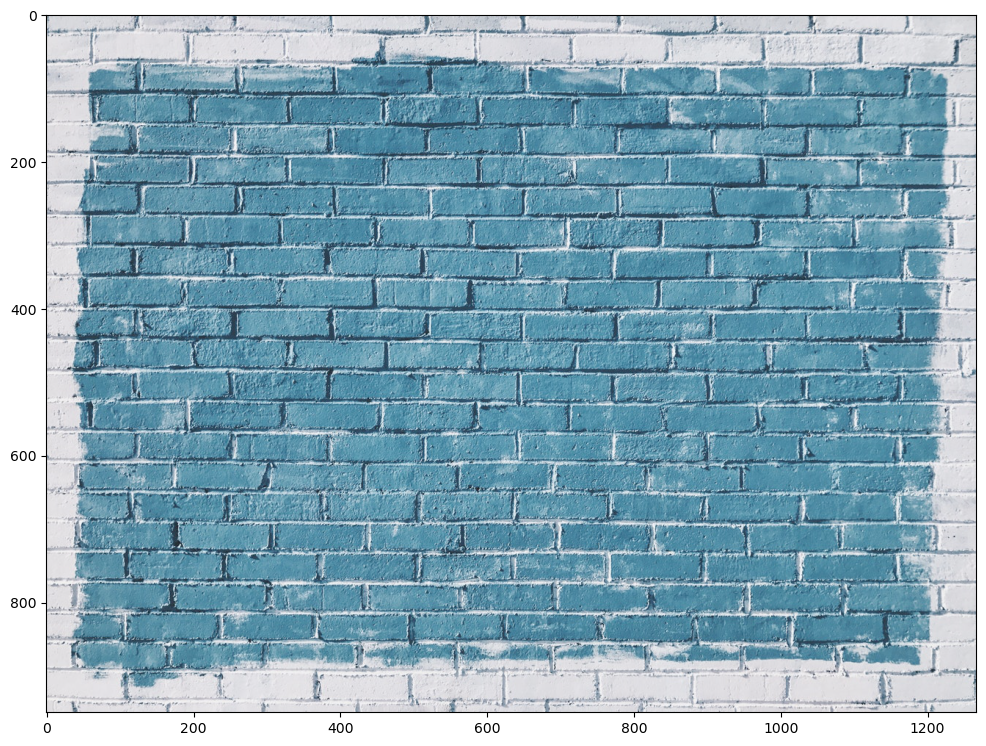

In [19]:
gamma = 0.8
gma_crt_img = np.power(image, gamma)
display_img(gma_crt_img)

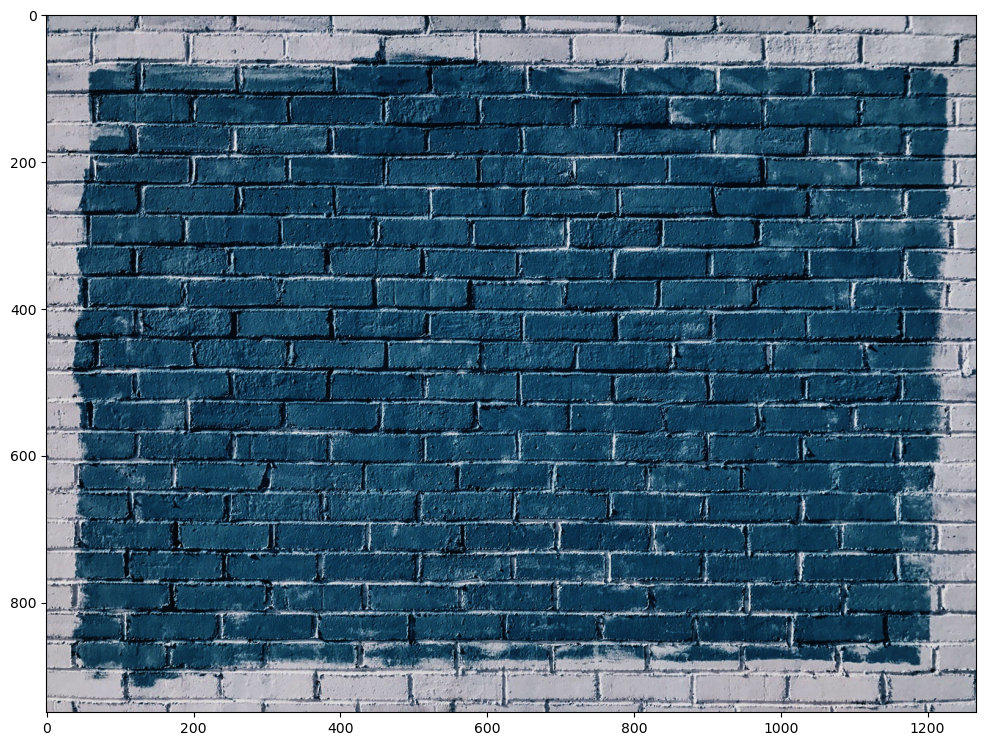

In [20]:
gamma = 2
gma_crt_img = np.power(image, gamma)
display_img(gma_crt_img)

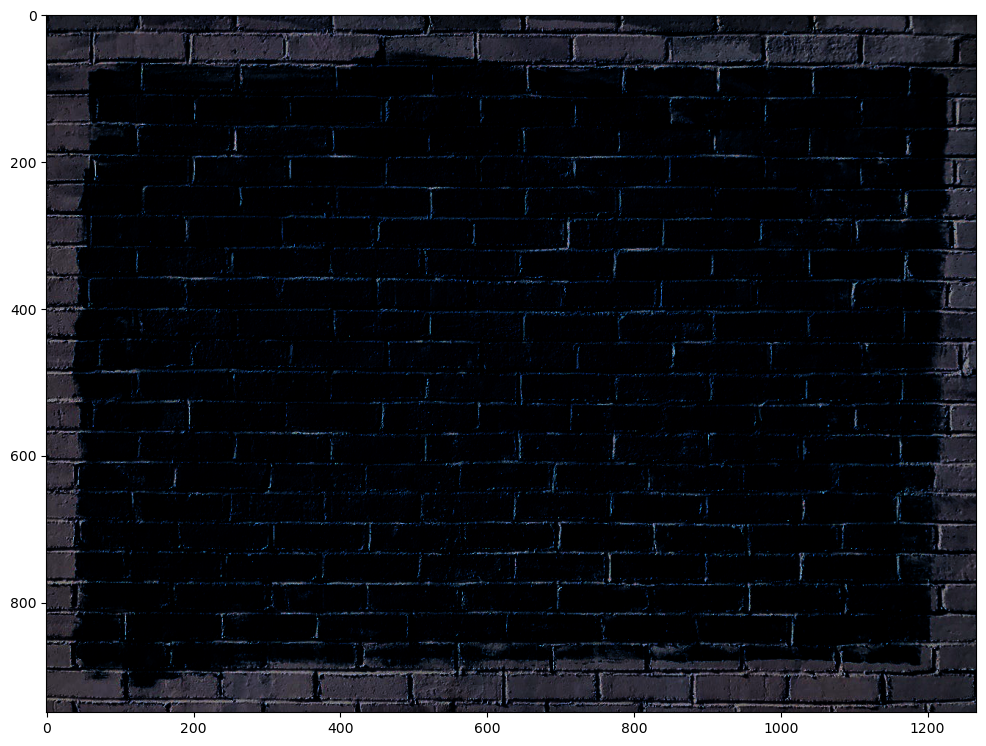

In [24]:
gamma = 10
gma_crt_img = np.power(image, gamma)
display_img(gma_crt_img)
#too dark to see image

## Kernel-Based Filtering (Convolution Filters)

### LOW PASS FILTER:

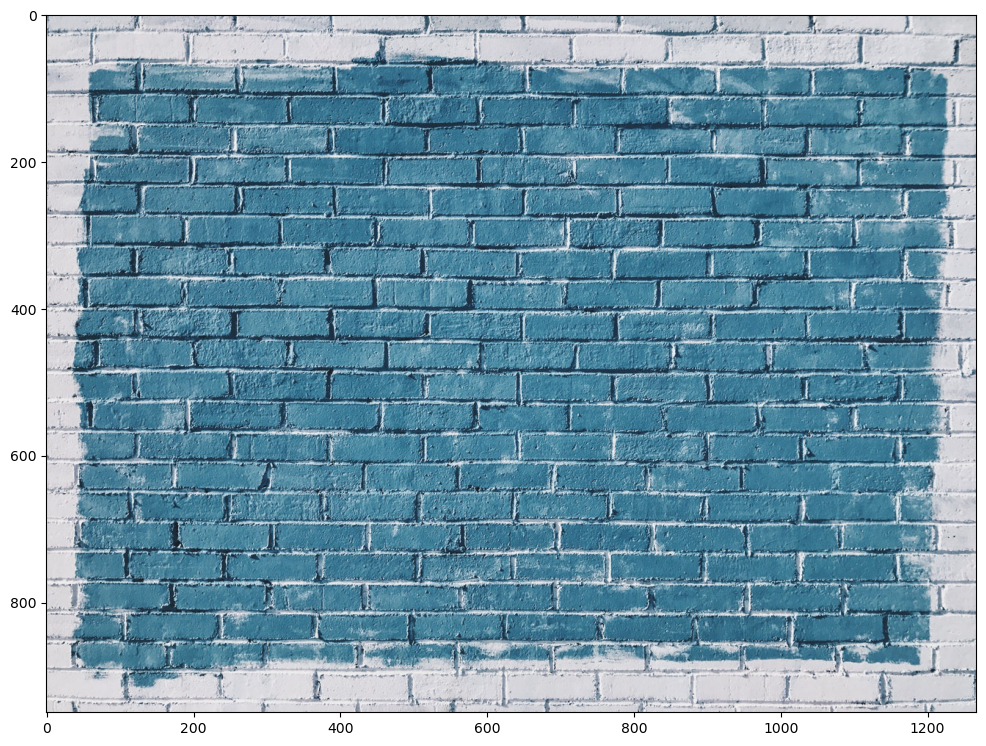

In [25]:
#Blurring:
#lowpass filter with 2D convolution.

image = load_img('Data/bricks.jpg')
display_img(image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


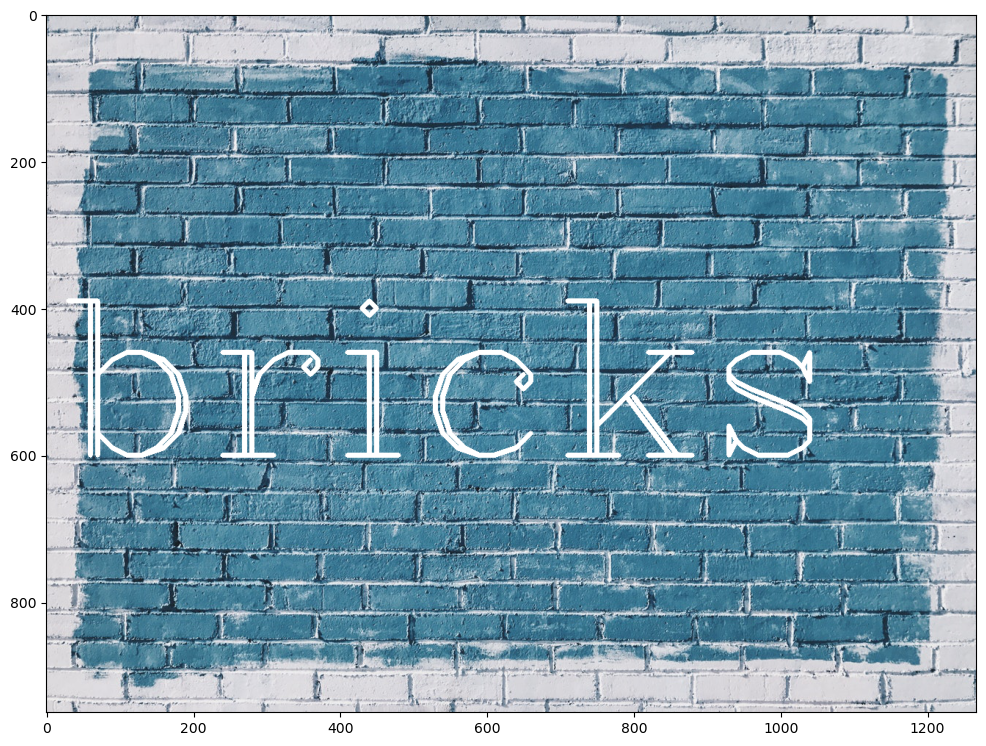

In [26]:
#putting text on image:(to see difference after blurring clearly

#font used(basic one)
font=cv2.FONT_HERSHEY_COMPLEX

cv2.putText(image, text="bricks", org=(10,600), fontFace=font, fontScale=10, color=[255,60,28], thickness=5)

display_img(image)

In [27]:
#lowpass filter:

#5*5 filter by 25 to keep simpler and the value that are summed around avg value 0-255

kernel = np.ones(shape=(5,5), dtype=np.float32)/25


### DEFAULT BLUR KERNEL:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.08752942..254.99995].


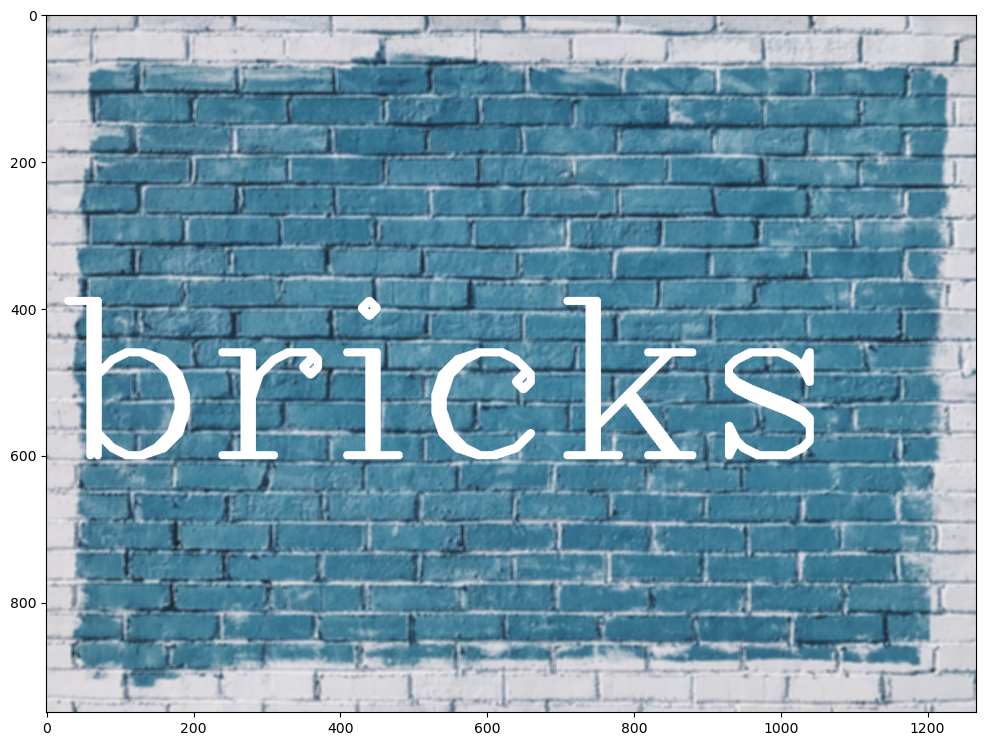

In [28]:
#now applying 2D filter:(5*5)
#desired depth=-1

dst = cv2.filter2D(image, -1, kernel)

display_img(dst) #this will give blurred image using kernel

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.08752941..255.0].


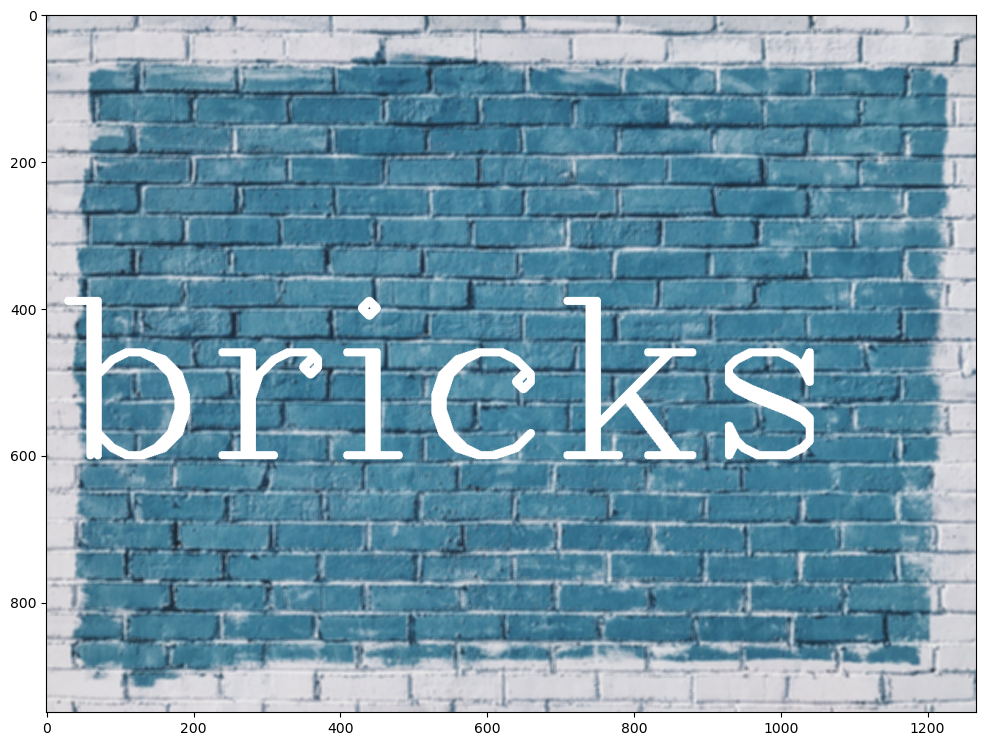

In [29]:
#default blurring
#pervious - defined kernel and used filter2D to apply

blurred_img = cv2.blur(image, ksize=(5,5))
#using cv2 built on blur kernel

display_img(blurred_img) #this will give blurred image using default kernel

#### GAUSSIAN KERNEL:

In [42]:
#Gaussian, median blurring - are essentially averaging techniques.

bricks_gusan = cv2.GaussianBlur(image,(5,5),10)

#sigma value-standard deviation

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.08743752..255.0].


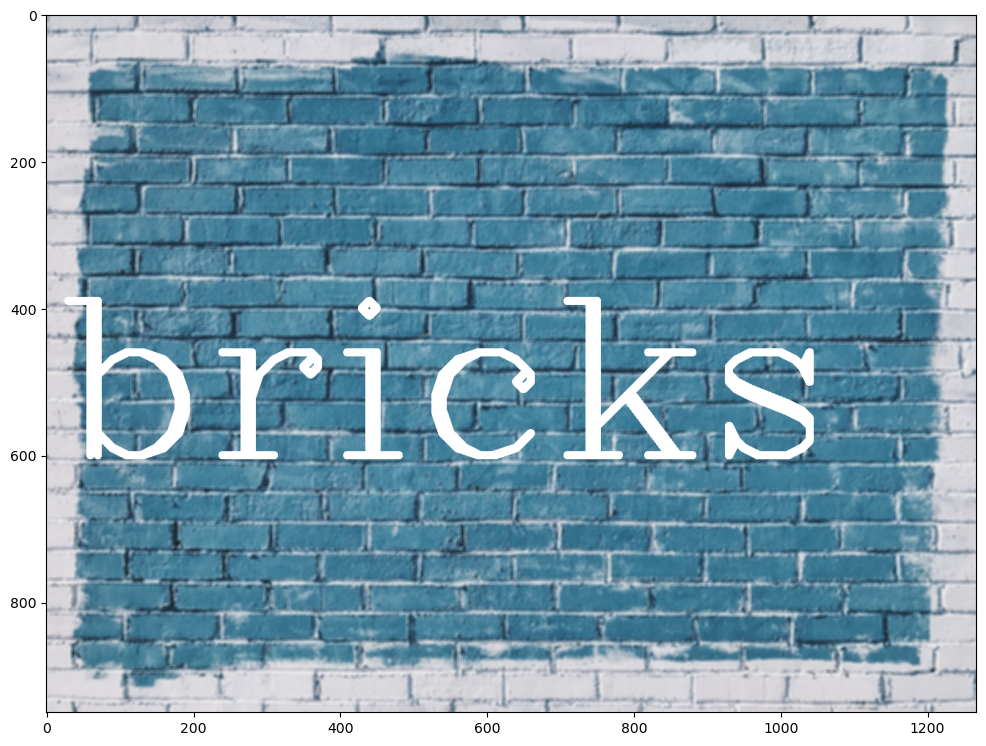

In [43]:
display_img(bricks_gusan)

#### MEDIAN KERNEL:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.08627451..255.0].


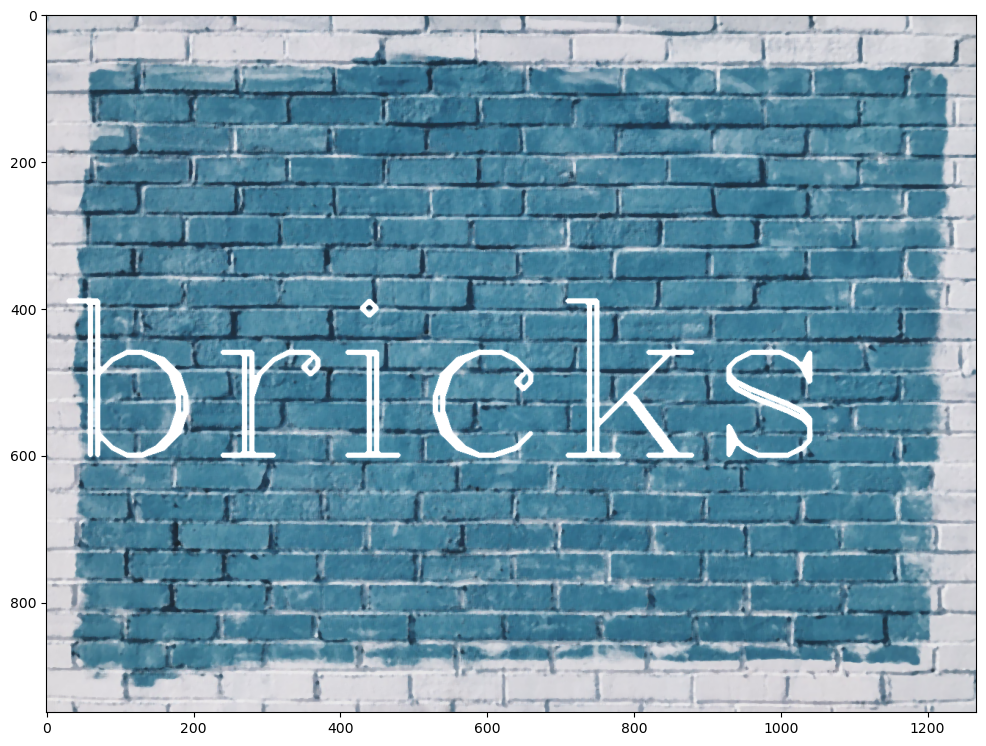

In [44]:
med_brcks = cv2.medianBlur(image, 5) #this has to be square kernel.

display_img(med_brcks)

In [45]:
#not as blurred as Gaussain
#keeps details by removing noise.


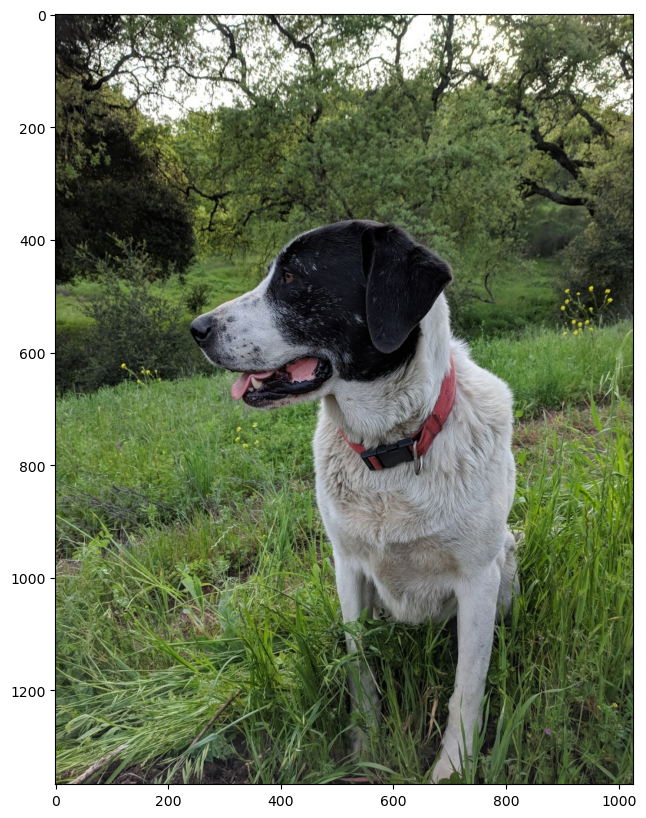

In [48]:
image_samy = load_img('Data/sammy.jpg') #in rgb
display_img(image_samy)

In [49]:
image_samy.shape

(1367, 1025, 3)

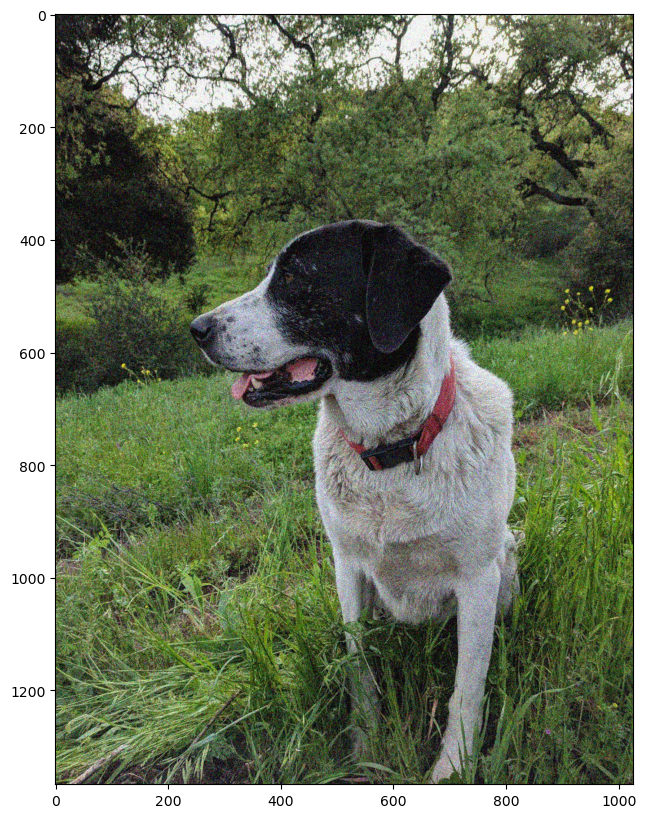

In [51]:
#in rgb
image_samy_noise = cv2.imread('Data/sammy_noise.jpg') 
display_img(image_samy_noise)

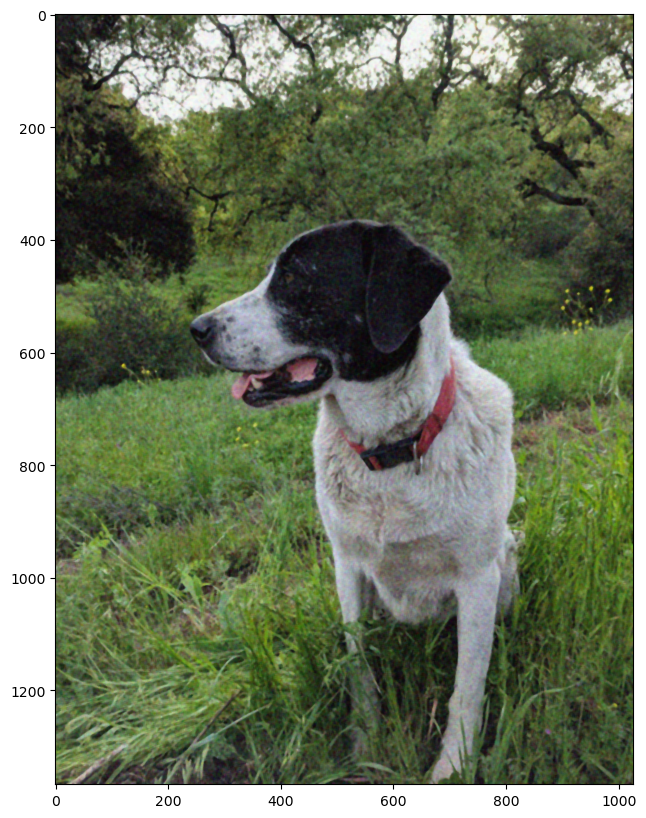

In [52]:
#there is noise in above image.(as it may added with some random values)

#remocing this noise using median blur:

med_samy = cv2.medianBlur(image_samy_noise, 5) #this has to be square kernel.

display_img(med_samy)

#### BILATERAL FILTERING:

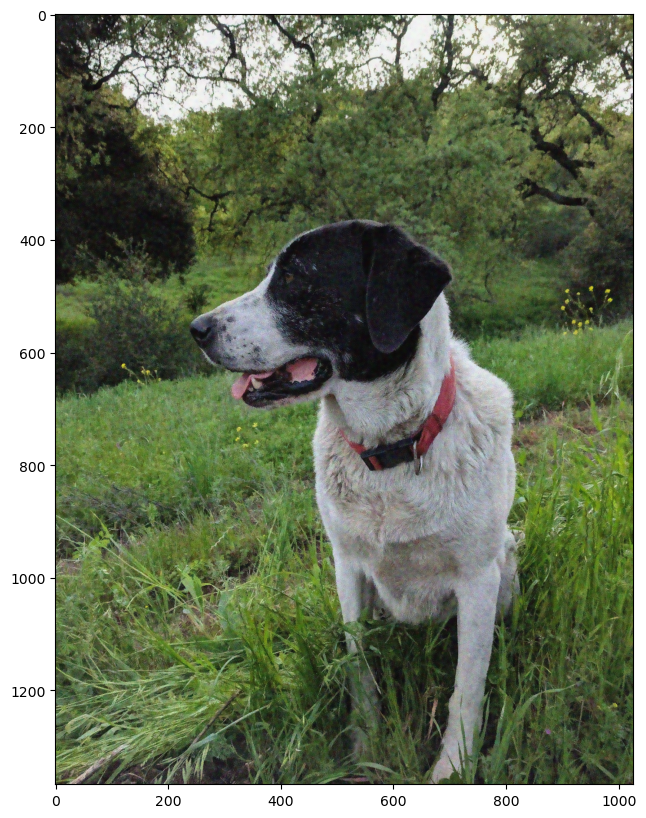

In [55]:
#bilateralFilter(src(source), d(Diameter of each pixel neighborhood), sigmaColor(Value of \sigma  in the color space. The greater the value, the colors farther to each other will start to get mixed.), sigmaSpace(Value of \sigma  in the coordinate space. The greater its value, the more further pixels will mix together, given that their colors lie within the sigmaColor range.))

blur_samy = cv2.bilateralFilter(image_samy_noise, 9, 75, 75)

#details kept noise reduced.
display_img(blur_samy)